<a href="https://colab.research.google.com/github/cha7ura/Covid-bar-chart-race/blob/main/covid.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install wget

  Created wheel for wget: filename=wget-3.2-cp36-none-any.whl size=9682 sha256=ae1932008800f19c6748a0c1c8b298ed2da7ef83cc07e3a52d1907303686f4a6
  Stored in directory: /root/.cache/pip/wheels/40/15/30/7d8f7cea2902b4db79e3fea550d7d7b85ecb27ef992b618f3f
Successfully built wget


In [2]:
import pandas as pd
import wget
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
import matplotlib.colors as mc
import colorsys
from IPython.display import HTML
from datetime import datetime
from random import randint

In [3]:
urls = [
    'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv',
    'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv',
    'https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_recovered_global.csv'
]
[wget.download(url) for url in urls]

['time_series_covid19_confirmed_global.csv',
 'time_series_covid19_deaths_global.csv',
 'time_series_covid19_recovered_global.csv']

In [4]:
confirmed_df = pd.read_csv('time_series_covid19_confirmed_global.csv')
deaths_df    = pd.read_csv('time_series_covid19_deaths_global.csv')
recovered_df = pd.read_csv('time_series_covid19_recovered_global.csv')

In [5]:
dates = confirmed_df.columns[4:]
confirmed_df_long = confirmed_df.melt(
    id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
    value_vars=dates, 
    var_name='Date', 
    value_name='Confirmed')

deaths_df_long = deaths_df.melt(
    id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
    value_vars=dates, 
    var_name='Date', 
    value_name='Deaths')

recovered_df_long = recovered_df.melt(
    id_vars=['Province/State', 'Country/Region', 'Lat', 'Long'], 
    value_vars=dates, 
    var_name='Date', 
    value_name='Recovered')

In [6]:
# Merging confirmed_df_long and deaths_df_long
full_table = confirmed_df_long.merge(
  right=deaths_df_long, 
  how='left',
  on=['Province/State', 'Country/Region', 'Date', 'Lat', 'Long']
)
# Merging full_table and recovered_df_long
full_table = full_table.merge(
  right=recovered_df_long, 
  how='left',
  on=['Province/State', 'Country/Region', 'Date', 'Lat', 'Long']
)

In [7]:
full_table['Date'] = pd.to_datetime(full_table['Date'])
full_grouped = full_table.groupby(['Date', 'Country/Region'])['Confirmed', 'Deaths', 'Recovered'].sum().reset_index()


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  


In [21]:
current_date = '2020-10-31' #@param {type:"date"}
parameter = 'Recovered' #@param ["Confirmed", "Deaths", "Recovered"]
numberOfCountries = 17 #@param {type:"slider", min:3, max:25, step:1}

In [22]:

def transform_color(color, amount = 0.7):
    try:
        c = mc.cnames[color]
    except:
        c = color
        c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])
all_names = full_grouped['Country/Region'].unique().tolist()
random_hex_colors = []
for i in range(len(all_names)):
    random_hex_colors.append('#' + '%06X' % randint(0, 0xFFFFFF))
    
rgb_colors = [transform_color(i, 1) for i in random_hex_colors]
rgb_colors_opacity = [rgb_colors[x] + (0.625,) for x in range(len(rgb_colors))]

In [23]:
def draw_barchart(date):
    dff = full_grouped[full_grouped['Date'].eq(date)].sort_values(by=parameter, ascending=True).tail(numberOfCountries)
    ax.clear()
    
    normal_colors = dict(zip(full_grouped['Country/Region'].unique(), rgb_colors_opacity))
    
    ax.barh(dff['Country/Region'], dff[parameter], color = [normal_colors[x] for x in dff['Country/Region']])
    dx = dff[parameter].max() / 50
    for i, (value, name) in enumerate(zip(dff[parameter], dff['Country/Region'])):
        ax.text(value-dx, i, name, size=10, weight=800, ha='right')
        ax.text(value+dx, i, f'{value:,.0f}',  size=10, ha='left',  va='center')
        
    # Style the bar
    
    ax.text(1, 0.3, date, transform=ax.transAxes, color='#777777', size=15, ha='right', weight=800)
    ax.text(0, 1.06, parameter , transform=ax.transAxes, size=12, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=14)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.12, '\n\nCOVID-19 {} cases Worldwide (Until {})'.format(parameter,current_date), transform=ax.transAxes, size=24, weight=600, ha='left')
    plt.box(False)
    plt.tight_layout()
    


In [24]:
dates=pd.Series(pd.to_datetime(full_grouped['Date'].unique()))
dates=dates.where(dates <= current_date)
dates.dropna(inplace=True)
dates = dates.astype(str)

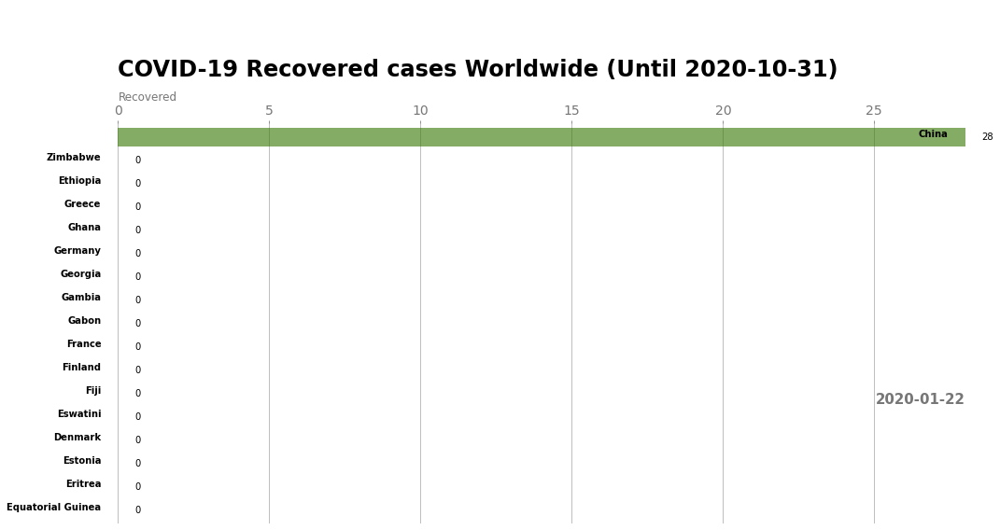

In [25]:
import matplotlib.animation as animation
from IPython.display import HTML
fig, ax = plt.subplots(figsize=(15, 8 ))
animator = animation.FuncAnimation(fig, draw_barchart, frames=dates)
HTML(animator.to_jshtml())